# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

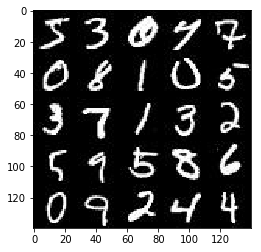

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

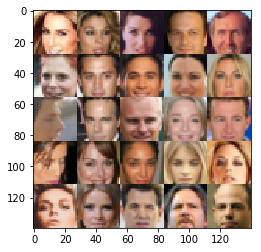

In [9]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


/Users/Rossonero/anaconda/envs/py36/lib/python3.6/site-packages/ipykernel/__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [11]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function

    inputs = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')

    return inputs, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [13]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    alpha = 0.2
    with tf.variable_scope('discriminator', reuse=reuse):
        #input layer is 28 x 28 x 3
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        #14x14x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        #7x7x128
        
        #x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        #bn3 = tf.layers.batch_normalization(x3, training=True)
        #relu3 = tf.maximum(alpha * bn3, bn3)
        #4x4x256
        
        # Flatten
        flat = tf.reshape(relu2, (-1, 7*7*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [ ]:
aaaa= True
not aaaa

In [31]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    alpha=0.2
    with tf.variable_scope('generator', reuse=not is_train):
        #First fuuly connected layer
        x1 = tf.layers.dense(z, 7*7*512)
        #reshape to start the conv stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        #7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 14x14x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 28x28x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=1, padding='same')
        # 28x28x3 now
        
        out = tf.tanh(logits)
        
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [24]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
                    tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
                    tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
                    tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    
    d_loss = d_loss_real + d_loss_fake
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [25]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    
    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [26]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [29]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model

    print(data_shape)
    input_real, input_z, _ = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
        
    d_loss, g_loss = model_loss(input_real, input_z,
                                              data_shape[3])        
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    saver = tf.train.Saver()

    losses = []
    steps = 0
    print_every = 50
    show_every = 50
    print('------start training------')
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                batch_images *= 2
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(steps, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, 64, input_z, data_shape[3], data_image_mode)
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

(60000, 28, 28, 1)
------start training------
Epoch 50/2... Discriminator Loss: 2.8471... Generator Loss: 0.0965


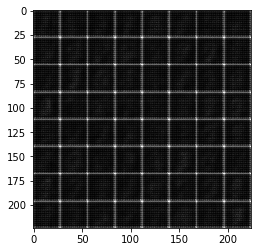

Epoch 100/2... Discriminator Loss: 2.0746... Generator Loss: 0.2389


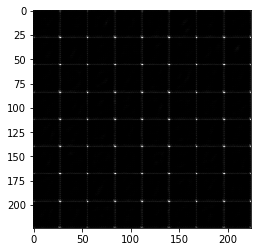

Epoch 150/2... Discriminator Loss: 2.3202... Generator Loss: 0.2282


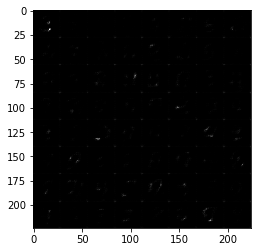

Epoch 200/2... Discriminator Loss: 1.9989... Generator Loss: 0.3133


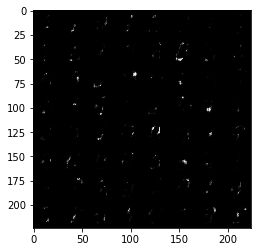

Epoch 250/2... Discriminator Loss: 1.7086... Generator Loss: 0.4043


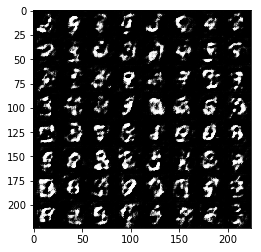

Epoch 300/2... Discriminator Loss: 1.7771... Generator Loss: 0.3002


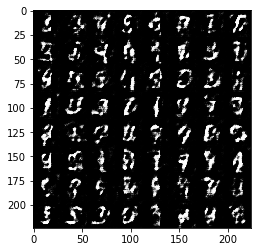

Epoch 350/2... Discriminator Loss: 1.2494... Generator Loss: 0.6598


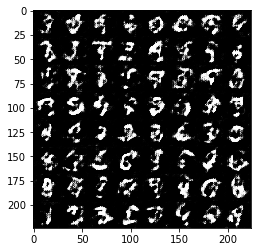

Epoch 400/2... Discriminator Loss: 1.9162... Generator Loss: 0.1865


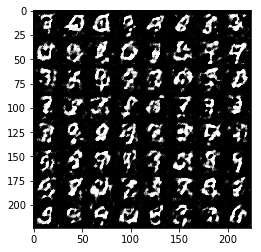

Epoch 450/2... Discriminator Loss: 1.0755... Generator Loss: 1.4722


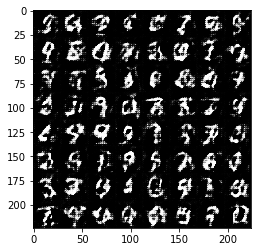

Epoch 500/2... Discriminator Loss: 1.7757... Generator Loss: 0.2270


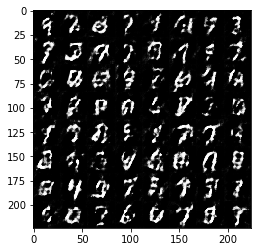

Epoch 550/2... Discriminator Loss: 1.2972... Generator Loss: 0.6064


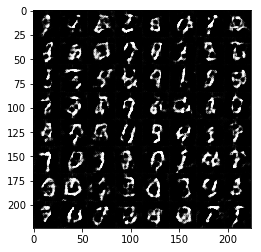

Epoch 600/2... Discriminator Loss: 1.5632... Generator Loss: 0.6140


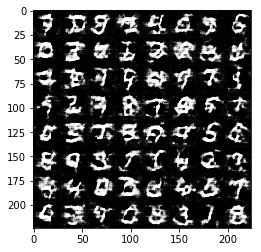

Epoch 650/2... Discriminator Loss: 1.9293... Generator Loss: 0.1951


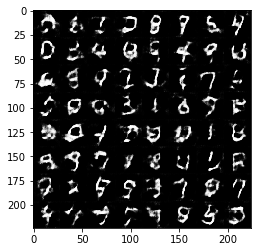

Epoch 700/2... Discriminator Loss: 1.4221... Generator Loss: 0.6325


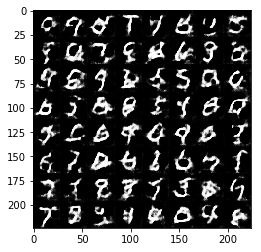

Epoch 750/2... Discriminator Loss: 1.5002... Generator Loss: 0.3816


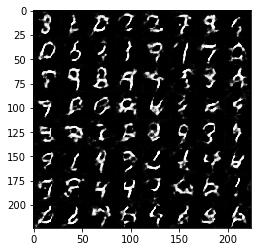

Epoch 800/2... Discriminator Loss: 2.3817... Generator Loss: 0.1185


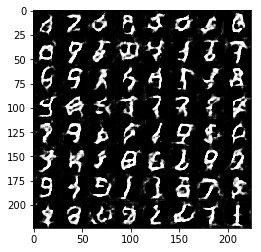

Epoch 850/2... Discriminator Loss: 1.2972... Generator Loss: 0.5774


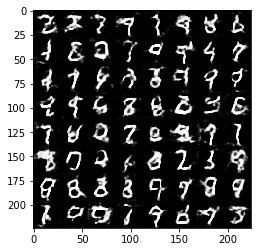

Epoch 900/2... Discriminator Loss: 1.2430... Generator Loss: 0.6460


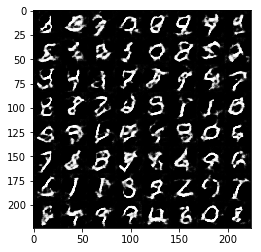

Epoch 950/2... Discriminator Loss: 1.4274... Generator Loss: 0.7434


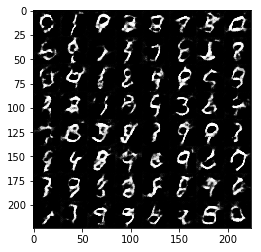

Epoch 1000/2... Discriminator Loss: 1.7858... Generator Loss: 0.2283


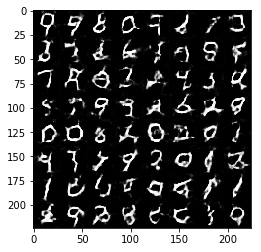

Epoch 1050/2... Discriminator Loss: 1.4183... Generator Loss: 0.4677


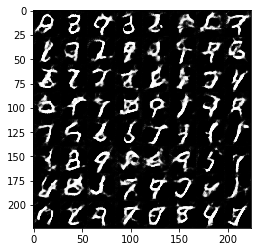

Epoch 1100/2... Discriminator Loss: 1.8257... Generator Loss: 0.3091


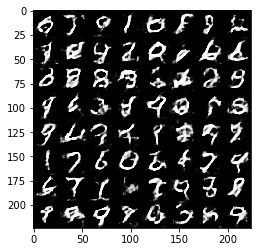

Epoch 1150/2... Discriminator Loss: 1.6454... Generator Loss: 0.4813


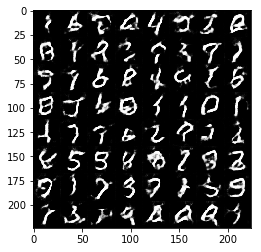

Epoch 1200/2... Discriminator Loss: 1.6091... Generator Loss: 0.7354


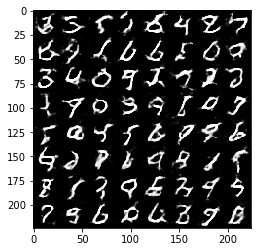

Epoch 1250/2... Discriminator Loss: 1.3907... Generator Loss: 0.5866


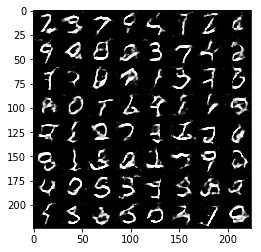

Epoch 1300/2... Discriminator Loss: 1.5824... Generator Loss: 0.3895


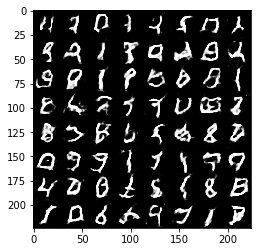

Epoch 1350/2... Discriminator Loss: 1.5211... Generator Loss: 0.4390


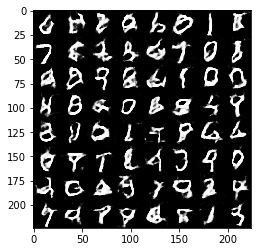

Epoch 1400/2... Discriminator Loss: 1.7183... Generator Loss: 0.4705


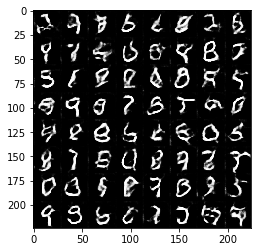

Epoch 1450/2... Discriminator Loss: 1.3169... Generator Loss: 0.5243


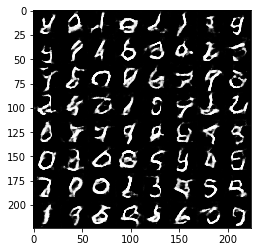

Epoch 1500/2... Discriminator Loss: 1.1706... Generator Loss: 0.9710


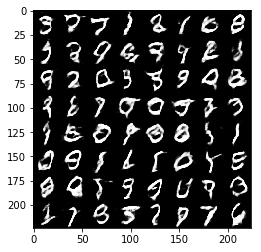

Epoch 1550/2... Discriminator Loss: 1.3827... Generator Loss: 0.7676


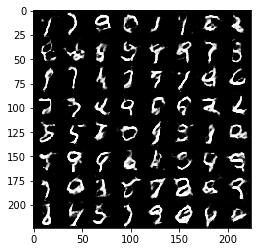

Epoch 1600/2... Discriminator Loss: 1.4179... Generator Loss: 0.6195


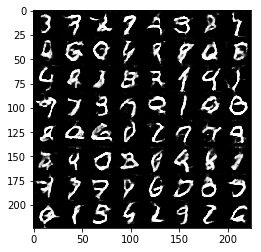

Epoch 1650/2... Discriminator Loss: 1.6065... Generator Loss: 0.3909


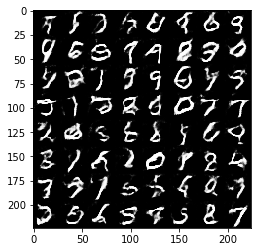

Epoch 1700/2... Discriminator Loss: 1.3506... Generator Loss: 0.5615


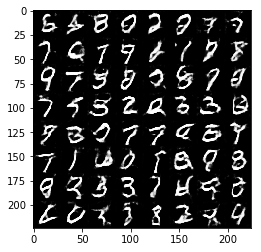

Epoch 1750/2... Discriminator Loss: 1.1802... Generator Loss: 0.6163


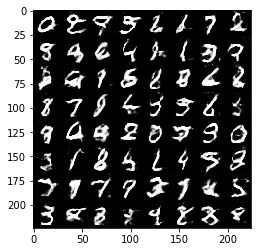

Epoch 1800/2... Discriminator Loss: 1.2927... Generator Loss: 0.5334


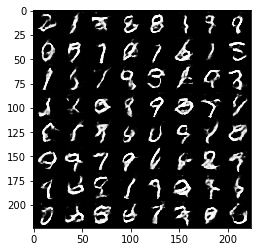

Epoch 1850/2... Discriminator Loss: 1.5036... Generator Loss: 0.3903


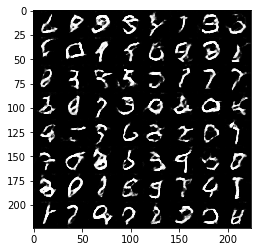

Epoch 1900/2... Discriminator Loss: 1.5630... Generator Loss: 0.3528


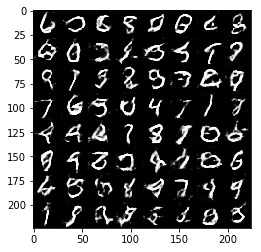

Epoch 1950/2... Discriminator Loss: 1.2715... Generator Loss: 1.0220


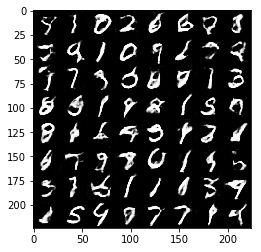

Epoch 2000/2... Discriminator Loss: 1.2368... Generator Loss: 1.0422


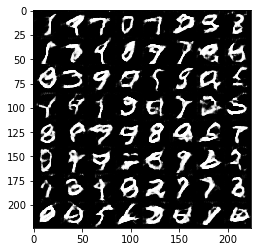

Epoch 2050/2... Discriminator Loss: 1.2237... Generator Loss: 0.6632


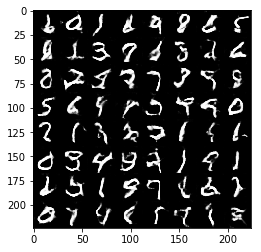

Epoch 2100/2... Discriminator Loss: 1.2800... Generator Loss: 0.8689


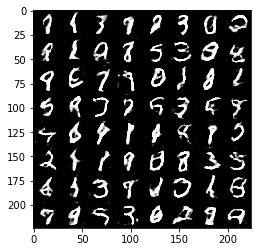

Epoch 2150/2... Discriminator Loss: 1.8009... Generator Loss: 0.2989


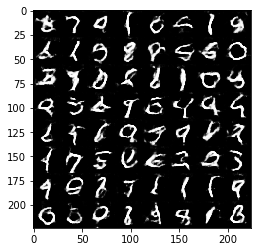

Epoch 2200/2... Discriminator Loss: 1.5451... Generator Loss: 0.5525


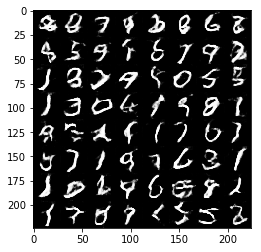

Epoch 2250/2... Discriminator Loss: 1.4861... Generator Loss: 0.3881


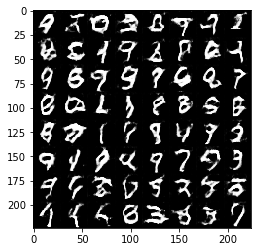

Epoch 2300/2... Discriminator Loss: 1.3704... Generator Loss: 0.4682


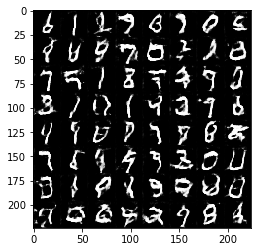

Epoch 2350/2... Discriminator Loss: 1.0196... Generator Loss: 0.7123


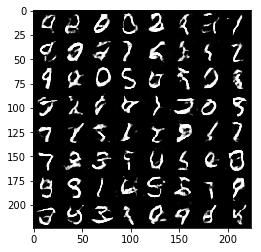

Epoch 2400/2... Discriminator Loss: 1.1228... Generator Loss: 1.0178


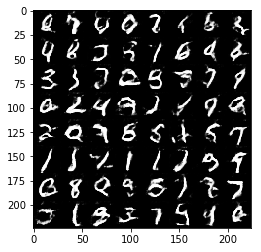

Epoch 2450/2... Discriminator Loss: 1.3060... Generator Loss: 0.6623


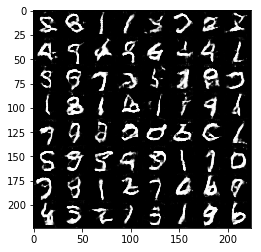

Epoch 2500/2... Discriminator Loss: 1.6336... Generator Loss: 0.3396


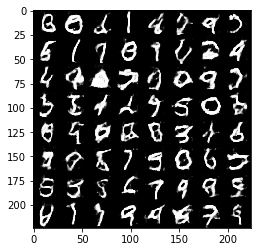

Epoch 2550/2... Discriminator Loss: 1.2042... Generator Loss: 0.5976


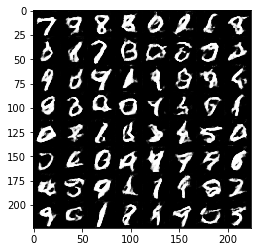

Epoch 2600/2... Discriminator Loss: 1.3826... Generator Loss: 0.3962


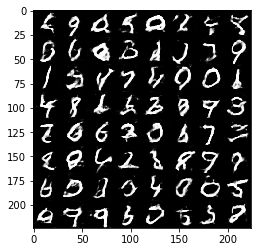

Epoch 2650/2... Discriminator Loss: 1.1939... Generator Loss: 0.9019


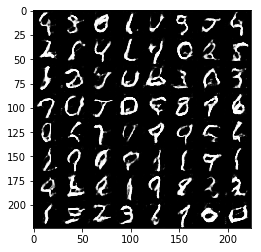

Epoch 2700/2... Discriminator Loss: 1.4900... Generator Loss: 0.4148


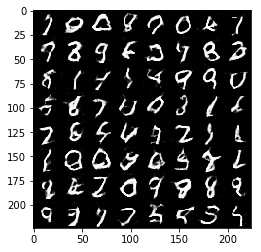

Epoch 2750/2... Discriminator Loss: 1.2343... Generator Loss: 0.5121


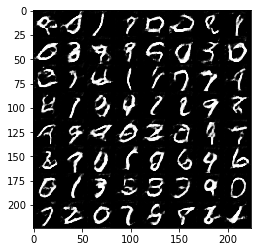

Epoch 2800/2... Discriminator Loss: 1.2899... Generator Loss: 0.4766


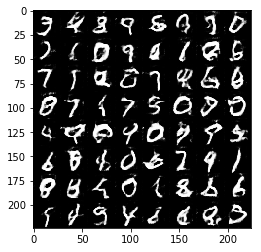

Epoch 2850/2... Discriminator Loss: 1.3675... Generator Loss: 0.4899


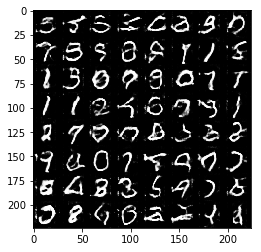

Epoch 2900/2... Discriminator Loss: 1.3764... Generator Loss: 0.9464


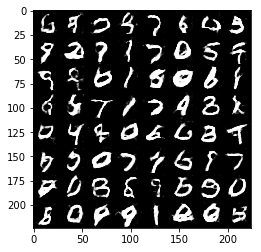

Epoch 2950/2... Discriminator Loss: 1.3139... Generator Loss: 0.4238


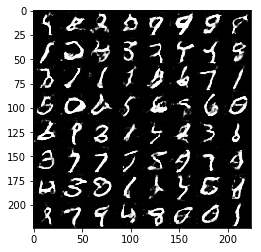

Epoch 3000/2... Discriminator Loss: 1.2713... Generator Loss: 0.5319


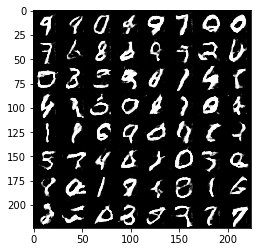

Epoch 3050/2... Discriminator Loss: 1.3368... Generator Loss: 0.9941


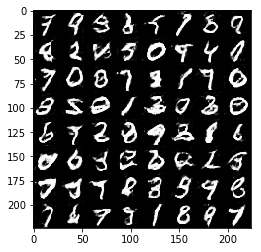

Epoch 3100/2... Discriminator Loss: 1.2839... Generator Loss: 0.6939


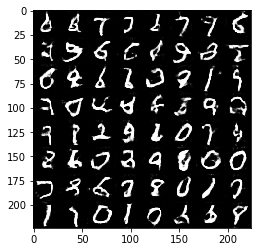

Epoch 3150/2... Discriminator Loss: 1.6047... Generator Loss: 1.3724


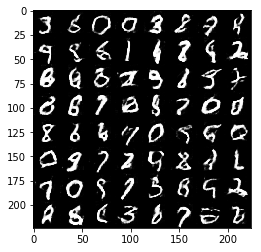

Epoch 3200/2... Discriminator Loss: 1.2532... Generator Loss: 0.4961


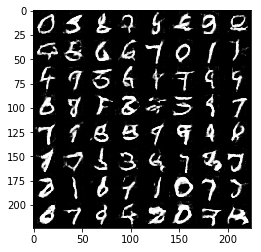

Epoch 3250/2... Discriminator Loss: 1.3387... Generator Loss: 0.4301


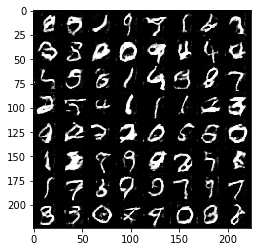

Epoch 3300/2... Discriminator Loss: 1.6131... Generator Loss: 0.2730


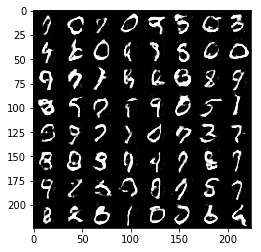

Epoch 3350/2... Discriminator Loss: 1.3179... Generator Loss: 0.9046


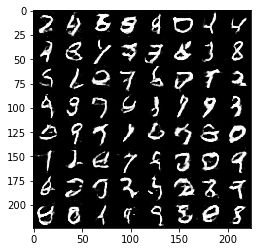

Epoch 3400/2... Discriminator Loss: 1.5898... Generator Loss: 0.3159


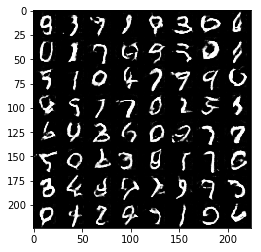

Epoch 3450/2... Discriminator Loss: 1.8480... Generator Loss: 1.9665


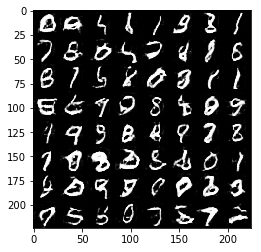

Epoch 3500/2... Discriminator Loss: 1.3244... Generator Loss: 0.5183


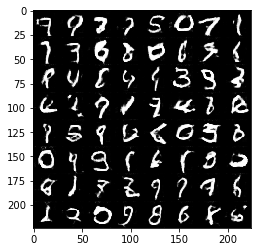

Epoch 3550/2... Discriminator Loss: 1.3150... Generator Loss: 0.4415


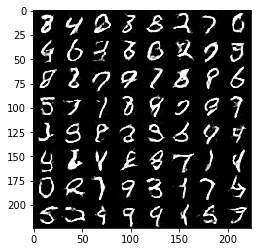

Epoch 3600/2... Discriminator Loss: 1.8191... Generator Loss: 0.3692


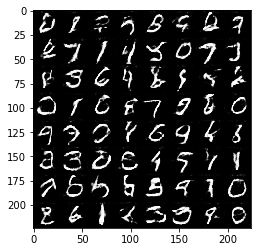

Epoch 3650/2... Discriminator Loss: 1.0252... Generator Loss: 0.7062


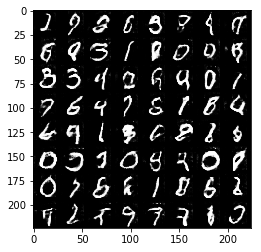

Epoch 3700/2... Discriminator Loss: 1.3702... Generator Loss: 1.3041


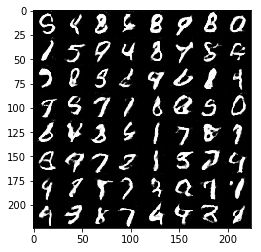

Epoch 3750/2... Discriminator Loss: 1.0890... Generator Loss: 0.8748


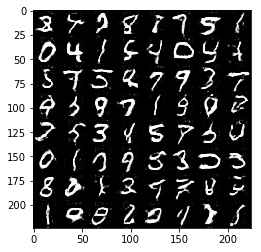

In [30]:

batch_size = 32
z_dim = 200
learning_rate = 0.0002
beta1 = 0.3

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2
#tf. reset.default_graph()
mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

(202599, 28, 28, 3)
------start training------
Epoch 50/1... Discriminator Loss: 3.7942... Generator Loss: 0.0577


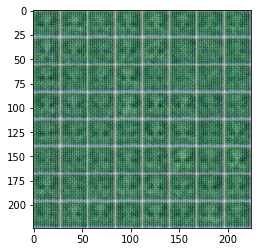

Epoch 100/1... Discriminator Loss: 2.8667... Generator Loss: 0.0936


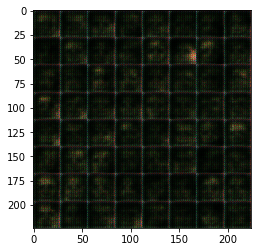

Epoch 150/1... Discriminator Loss: 3.0712... Generator Loss: 0.0630


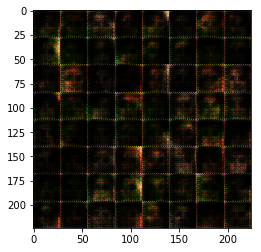

Epoch 200/1... Discriminator Loss: 1.1243... Generator Loss: 3.2965


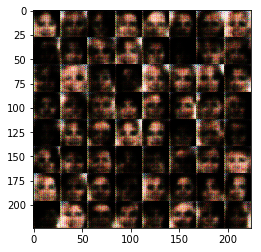

Epoch 250/1... Discriminator Loss: 1.0036... Generator Loss: 2.6184


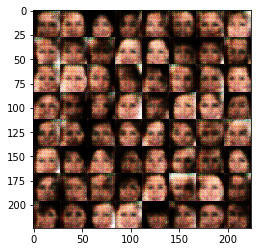

Epoch 300/1... Discriminator Loss: 0.5811... Generator Loss: 1.3548


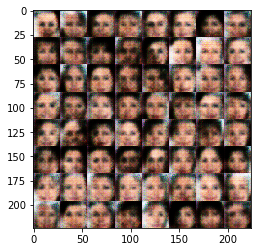

Epoch 350/1... Discriminator Loss: 0.5424... Generator Loss: 2.4825


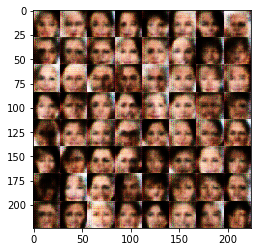

Epoch 400/1... Discriminator Loss: 0.6018... Generator Loss: 1.3682


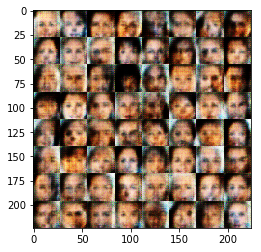

Epoch 450/1... Discriminator Loss: 0.9580... Generator Loss: 4.8050


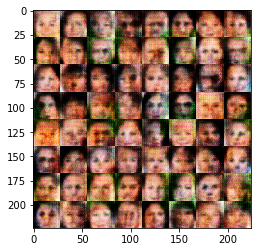

Epoch 500/1... Discriminator Loss: 2.3739... Generator Loss: 0.1274


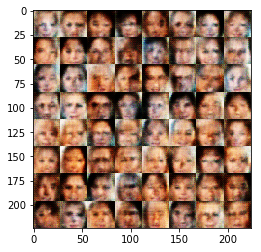

Epoch 550/1... Discriminator Loss: 0.9770... Generator Loss: 0.7622


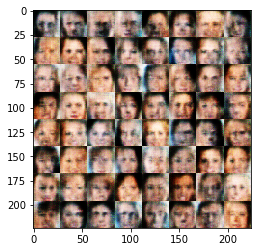

Epoch 600/1... Discriminator Loss: 0.3887... Generator Loss: 2.3318


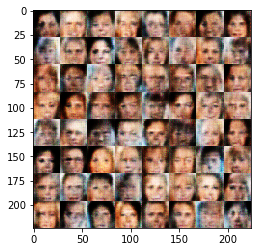

Epoch 650/1... Discriminator Loss: 0.3287... Generator Loss: 4.9040


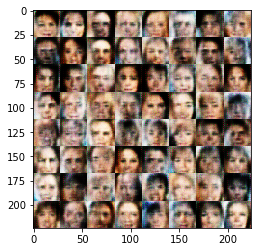

Epoch 700/1... Discriminator Loss: 0.8171... Generator Loss: 2.4552


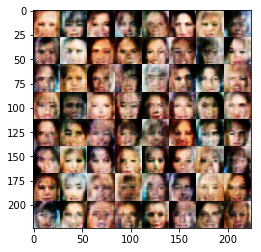

Epoch 750/1... Discriminator Loss: 0.8373... Generator Loss: 0.8697


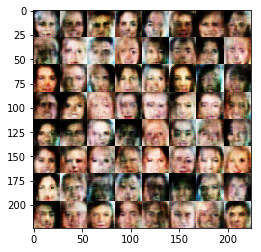

Epoch 800/1... Discriminator Loss: 0.4022... Generator Loss: 2.4299


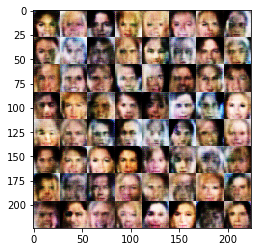

Epoch 850/1... Discriminator Loss: 1.5329... Generator Loss: 0.4864


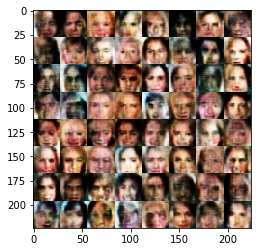

Epoch 900/1... Discriminator Loss: 1.2273... Generator Loss: 0.5880


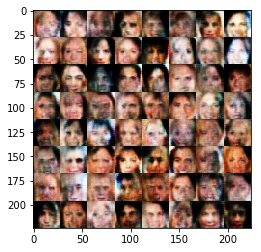

Epoch 950/1... Discriminator Loss: 1.7538... Generator Loss: 0.5161


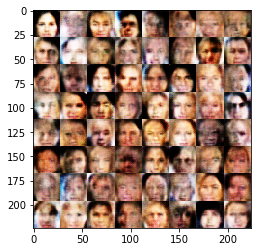

Epoch 1000/1... Discriminator Loss: 1.4319... Generator Loss: 0.5586


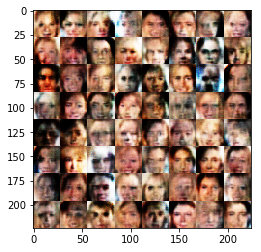

Epoch 1050/1... Discriminator Loss: 1.2348... Generator Loss: 1.3477


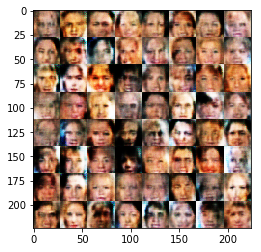

Epoch 1100/1... Discriminator Loss: 1.0302... Generator Loss: 0.7047


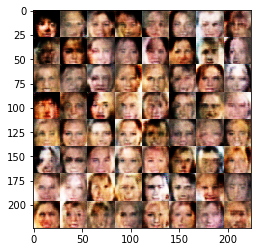

Epoch 1150/1... Discriminator Loss: 2.1903... Generator Loss: 0.1819


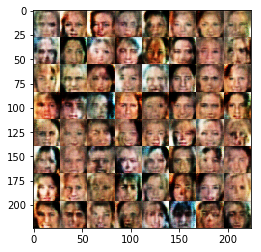

Epoch 1200/1... Discriminator Loss: 1.5374... Generator Loss: 0.6585


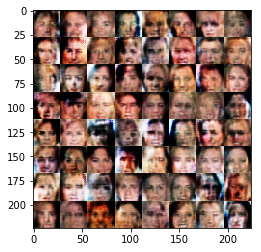

Epoch 1250/1... Discriminator Loss: 1.9588... Generator Loss: 0.1971


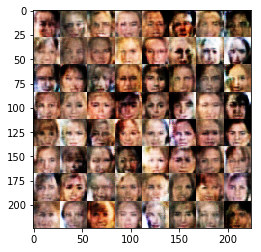

Epoch 1300/1... Discriminator Loss: 0.6414... Generator Loss: 1.6568


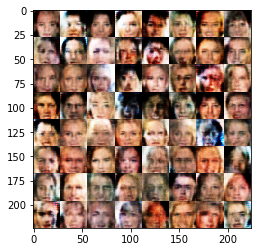

Epoch 1350/1... Discriminator Loss: 1.0316... Generator Loss: 1.1047


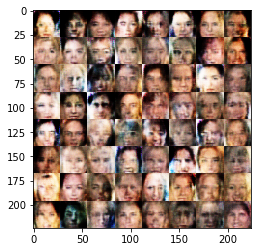

Epoch 1400/1... Discriminator Loss: 1.6298... Generator Loss: 0.3665


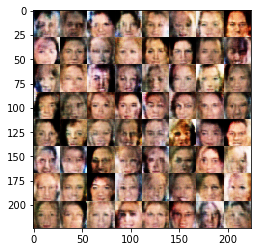

Epoch 1450/1... Discriminator Loss: 1.0868... Generator Loss: 1.5693


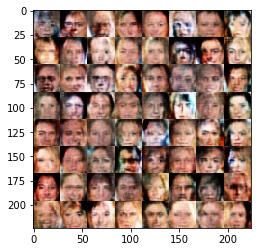

Epoch 1500/1... Discriminator Loss: 1.1349... Generator Loss: 1.5300


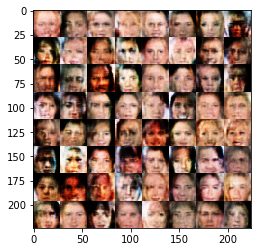

Epoch 1550/1... Discriminator Loss: 1.9227... Generator Loss: 0.2158


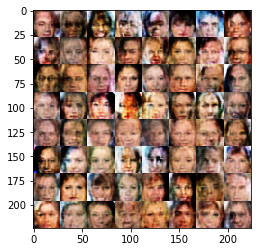

Epoch 1600/1... Discriminator Loss: 1.2273... Generator Loss: 0.5848


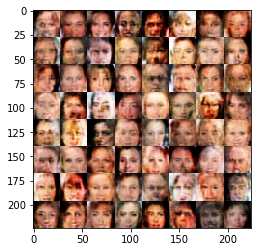

Epoch 1650/1... Discriminator Loss: 2.2292... Generator Loss: 1.2346


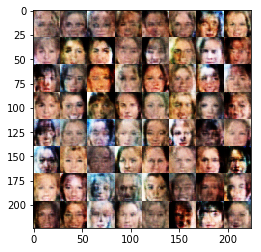

Epoch 1700/1... Discriminator Loss: 1.2314... Generator Loss: 1.0145


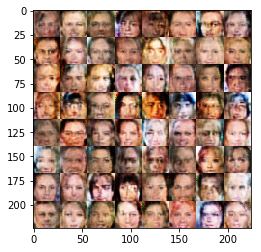

Epoch 1750/1... Discriminator Loss: 0.8515... Generator Loss: 1.0276


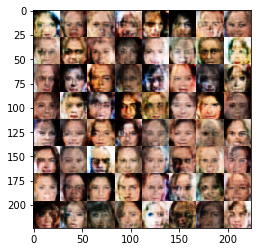

Epoch 1800/1... Discriminator Loss: 1.0845... Generator Loss: 0.8880


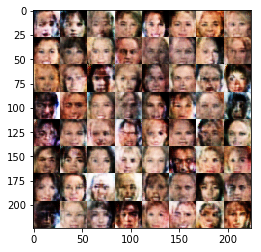

Epoch 1850/1... Discriminator Loss: 1.2482... Generator Loss: 0.6384


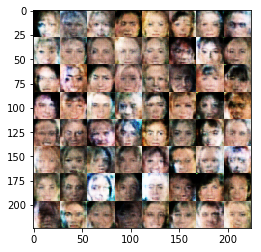

Epoch 1900/1... Discriminator Loss: 1.8673... Generator Loss: 0.2568


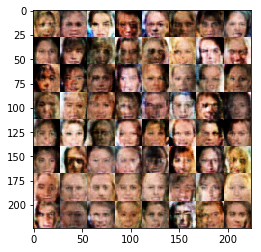

Epoch 1950/1... Discriminator Loss: 2.1572... Generator Loss: 1.0095


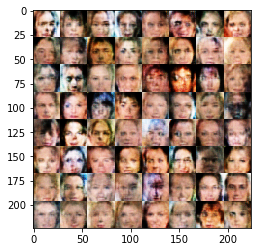

Epoch 2000/1... Discriminator Loss: 1.0946... Generator Loss: 0.6731


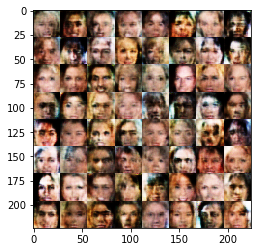

Epoch 2050/1... Discriminator Loss: 1.3170... Generator Loss: 0.4323


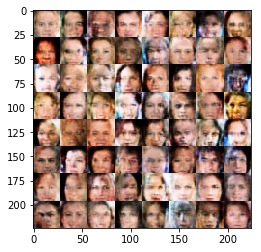

Epoch 2100/1... Discriminator Loss: 1.2547... Generator Loss: 0.6366


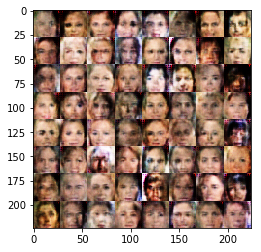

Epoch 2150/1... Discriminator Loss: 2.0264... Generator Loss: 0.2058


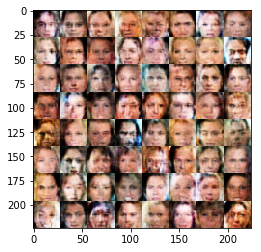

Epoch 2200/1... Discriminator Loss: 1.3972... Generator Loss: 0.4596


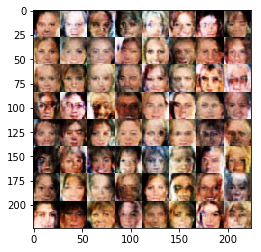

Epoch 2250/1... Discriminator Loss: 2.4157... Generator Loss: 0.9584


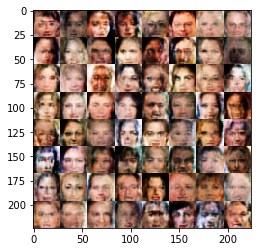

Epoch 2300/1... Discriminator Loss: 1.9182... Generator Loss: 0.2699


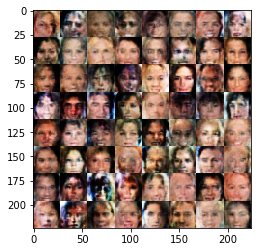

Epoch 2350/1... Discriminator Loss: 1.5396... Generator Loss: 0.4250


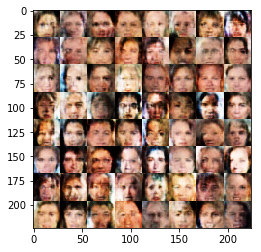

Epoch 2400/1... Discriminator Loss: 1.6714... Generator Loss: 0.3810


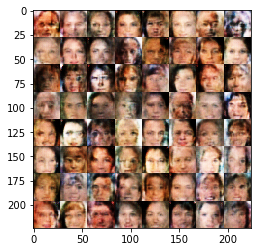

Epoch 2450/1... Discriminator Loss: 1.4895... Generator Loss: 0.4779


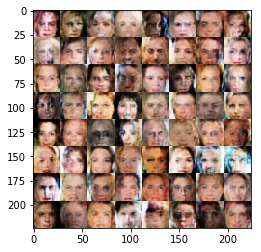

Epoch 2500/1... Discriminator Loss: 1.1929... Generator Loss: 0.9587


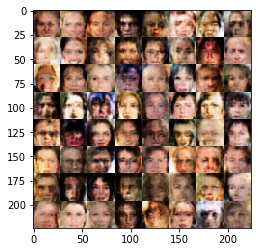

Epoch 2550/1... Discriminator Loss: 0.6906... Generator Loss: 1.5353


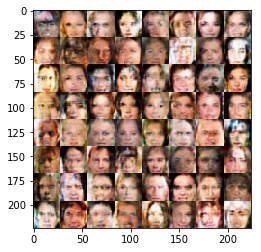

Epoch 2600/1... Discriminator Loss: 2.2106... Generator Loss: 0.1504


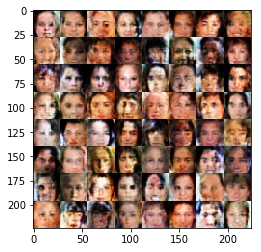

Epoch 2650/1... Discriminator Loss: 0.8592... Generator Loss: 0.8400


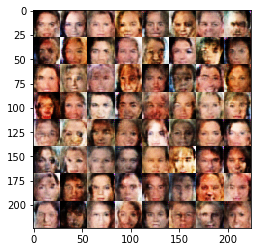

Epoch 2700/1... Discriminator Loss: 1.4994... Generator Loss: 0.4116


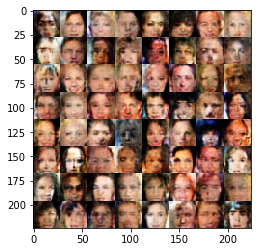

Epoch 2750/1... Discriminator Loss: 1.3364... Generator Loss: 0.5221


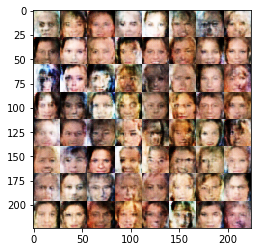

Epoch 2800/1... Discriminator Loss: 1.2308... Generator Loss: 0.5401


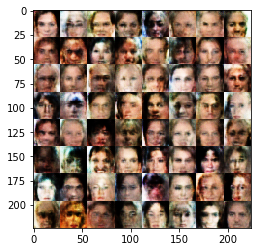

Epoch 2850/1... Discriminator Loss: 0.6099... Generator Loss: 1.4329


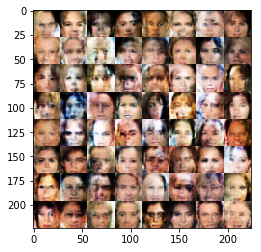

Epoch 2900/1... Discriminator Loss: 1.6786... Generator Loss: 0.6440


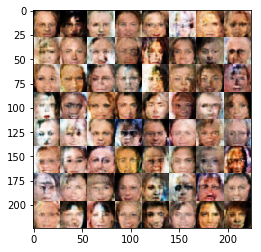

Epoch 2950/1... Discriminator Loss: 1.2673... Generator Loss: 0.7889


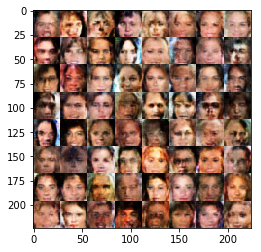

Epoch 3000/1... Discriminator Loss: 1.4613... Generator Loss: 0.7084


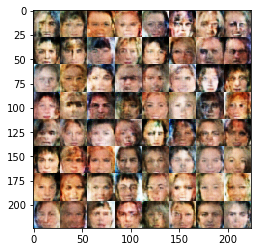

Epoch 3050/1... Discriminator Loss: 0.9258... Generator Loss: 0.9057


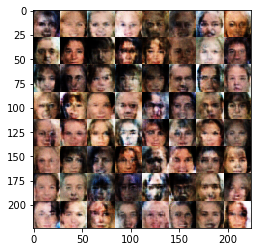

Epoch 3100/1... Discriminator Loss: 1.6867... Generator Loss: 0.4277


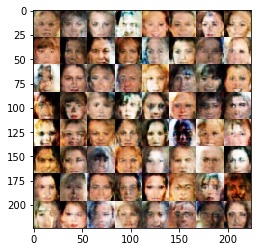

Epoch 3150/1... Discriminator Loss: 1.5092... Generator Loss: 0.4316


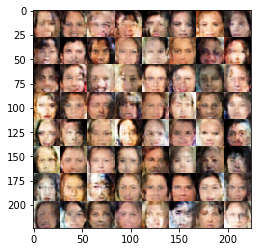

Epoch 3200/1... Discriminator Loss: 1.3707... Generator Loss: 0.5847


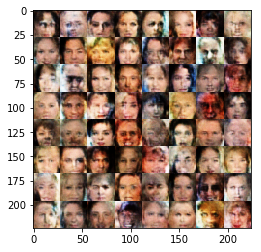

Epoch 3250/1... Discriminator Loss: 1.5491... Generator Loss: 0.4864


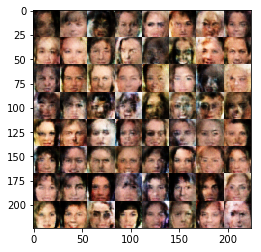

Epoch 3300/1... Discriminator Loss: 1.1349... Generator Loss: 0.9102


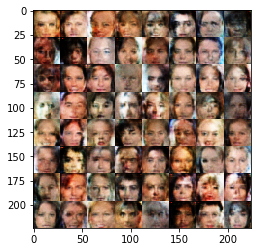

Epoch 3350/1... Discriminator Loss: 1.6783... Generator Loss: 0.3097


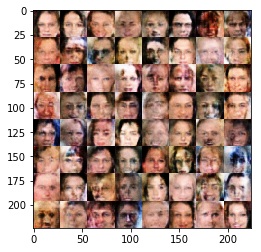

Epoch 3400/1... Discriminator Loss: 0.9579... Generator Loss: 0.7511


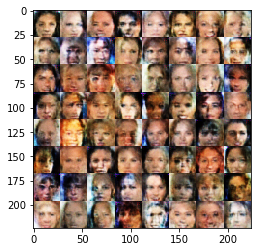

Epoch 3450/1... Discriminator Loss: 2.0816... Generator Loss: 0.2049


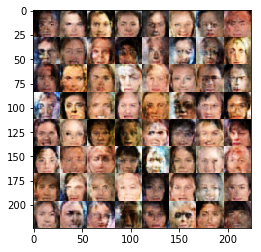

Epoch 3500/1... Discriminator Loss: 1.4376... Generator Loss: 0.5632


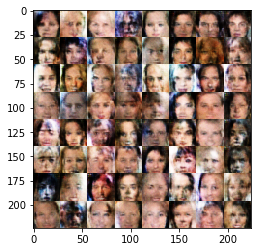

Epoch 3550/1... Discriminator Loss: 1.4398... Generator Loss: 0.5299


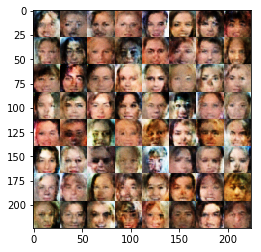

Epoch 3600/1... Discriminator Loss: 1.0940... Generator Loss: 1.1160


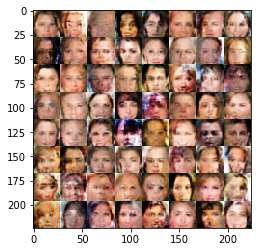

Epoch 3650/1... Discriminator Loss: 1.3509... Generator Loss: 0.5463


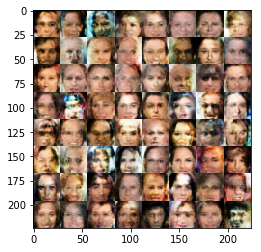

Epoch 3700/1... Discriminator Loss: 1.4823... Generator Loss: 0.5677


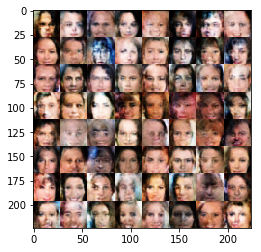

Epoch 3750/1... Discriminator Loss: 1.1773... Generator Loss: 0.8733


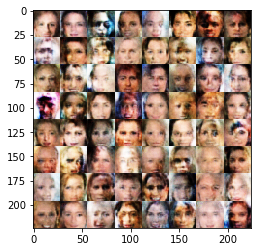

Epoch 3800/1... Discriminator Loss: 0.9313... Generator Loss: 1.6949


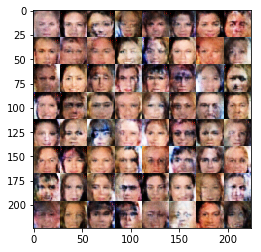

Epoch 3850/1... Discriminator Loss: 0.8419... Generator Loss: 1.3902


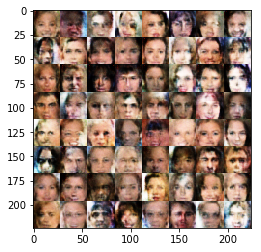

Epoch 3900/1... Discriminator Loss: 0.7259... Generator Loss: 1.3962


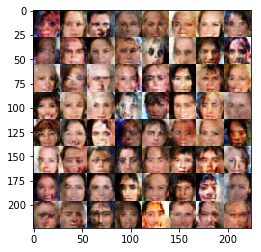

Epoch 3950/1... Discriminator Loss: 1.5254... Generator Loss: 0.4885


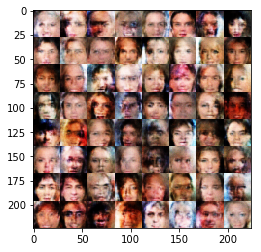

Epoch 4000/1... Discriminator Loss: 1.0980... Generator Loss: 0.7670


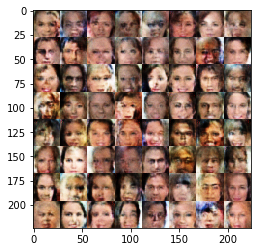

Epoch 4050/1... Discriminator Loss: 1.2977... Generator Loss: 1.0318


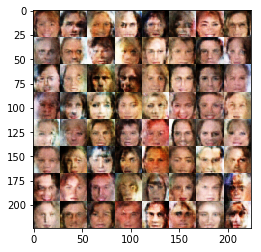

Epoch 4100/1... Discriminator Loss: 1.3757... Generator Loss: 0.6557


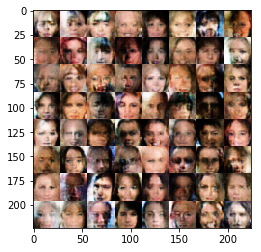

Epoch 4150/1... Discriminator Loss: 1.7393... Generator Loss: 0.4180


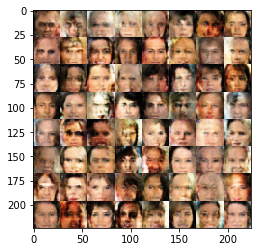

Epoch 4200/1... Discriminator Loss: 1.9880... Generator Loss: 0.2181


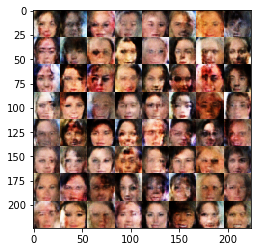

Epoch 4250/1... Discriminator Loss: 1.2399... Generator Loss: 0.5407


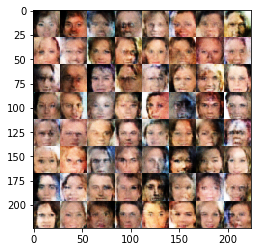

Epoch 4300/1... Discriminator Loss: 1.4621... Generator Loss: 0.4391


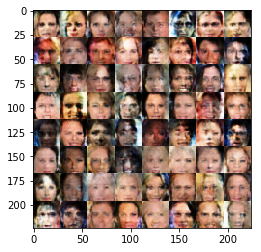

Epoch 4350/1... Discriminator Loss: 1.7580... Generator Loss: 0.4103


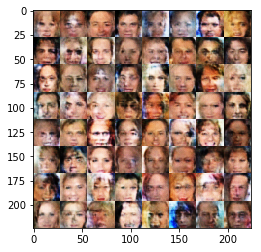

Epoch 4400/1... Discriminator Loss: 0.7822... Generator Loss: 1.5440


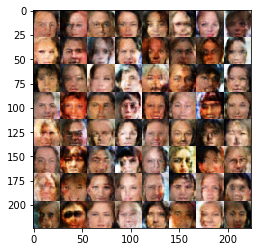

Epoch 4450/1... Discriminator Loss: 1.8663... Generator Loss: 0.2597


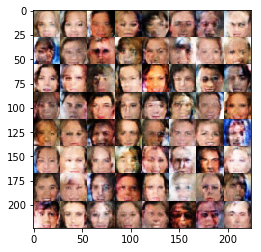

Epoch 4500/1... Discriminator Loss: 1.7730... Generator Loss: 0.2822


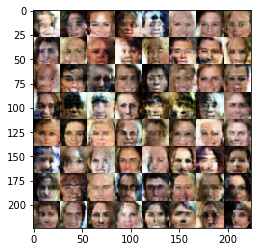

Epoch 4550/1... Discriminator Loss: 1.5507... Generator Loss: 0.3608


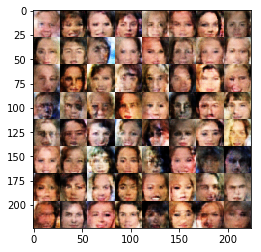

Epoch 4600/1... Discriminator Loss: 1.1836... Generator Loss: 0.5765


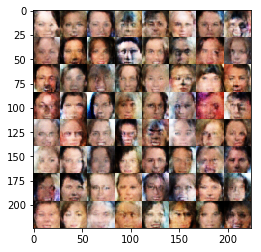

Epoch 4650/1... Discriminator Loss: 1.3877... Generator Loss: 0.6167


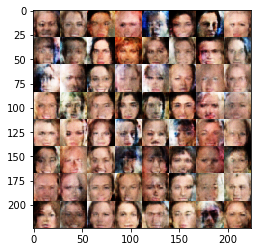

Epoch 4700/1... Discriminator Loss: 1.5718... Generator Loss: 0.3994


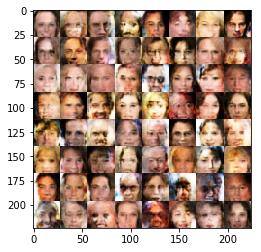

Epoch 4750/1... Discriminator Loss: 0.7042... Generator Loss: 2.2843


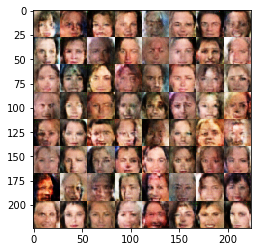

Epoch 4800/1... Discriminator Loss: 0.6113... Generator Loss: 3.5394


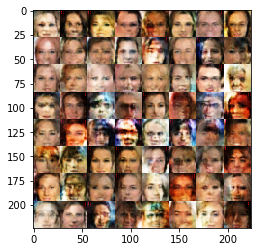

Epoch 4850/1... Discriminator Loss: 1.5754... Generator Loss: 0.7254


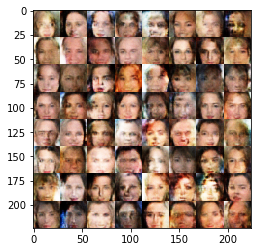

Epoch 4900/1... Discriminator Loss: 1.3551... Generator Loss: 0.4437


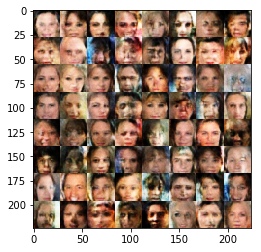

Epoch 4950/1... Discriminator Loss: 1.5413... Generator Loss: 0.4363


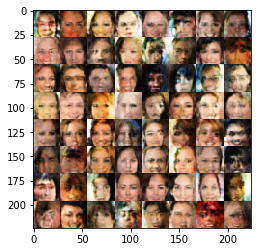

Epoch 5000/1... Discriminator Loss: 1.4033... Generator Loss: 0.5435


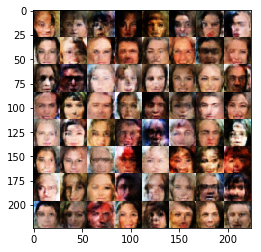

Epoch 5050/1... Discriminator Loss: 1.5858... Generator Loss: 0.3334


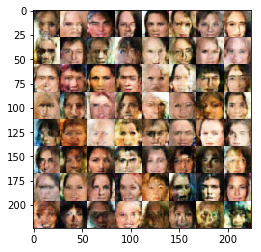

Epoch 5100/1... Discriminator Loss: 1.3614... Generator Loss: 0.6891


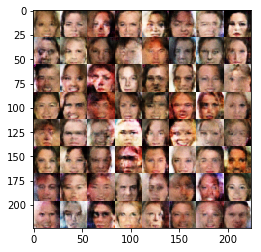

Epoch 5150/1... Discriminator Loss: 1.5855... Generator Loss: 0.4511


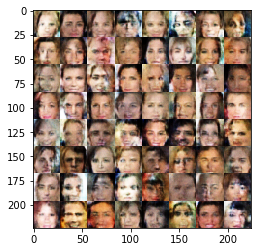

Epoch 5200/1... Discriminator Loss: 1.5642... Generator Loss: 0.8988


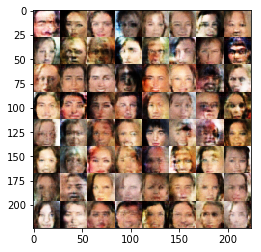

Epoch 5250/1... Discriminator Loss: 1.4957... Generator Loss: 0.5148


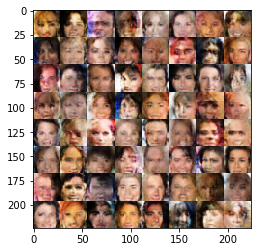

Epoch 5300/1... Discriminator Loss: 1.5934... Generator Loss: 0.3755


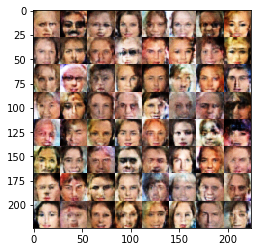

Epoch 5350/1... Discriminator Loss: 1.3986... Generator Loss: 0.4736


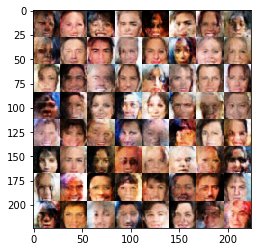

Epoch 5400/1... Discriminator Loss: 1.5514... Generator Loss: 0.5051


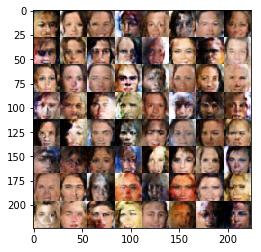

Epoch 5450/1... Discriminator Loss: 1.5831... Generator Loss: 0.5048


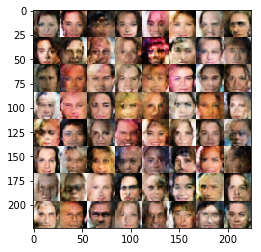

Epoch 5500/1... Discriminator Loss: 1.3760... Generator Loss: 0.6036


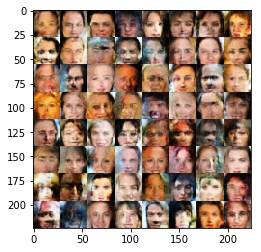

Epoch 5550/1... Discriminator Loss: 1.6502... Generator Loss: 0.4379


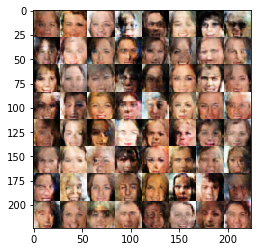

Epoch 5600/1... Discriminator Loss: 1.5743... Generator Loss: 0.5185


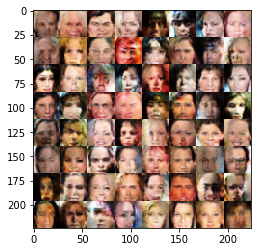

Epoch 5650/1... Discriminator Loss: 1.2661... Generator Loss: 0.6027


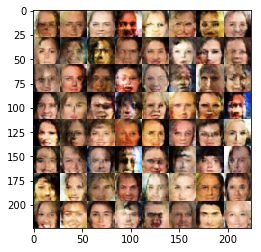

Epoch 5700/1... Discriminator Loss: 1.3889... Generator Loss: 0.5920


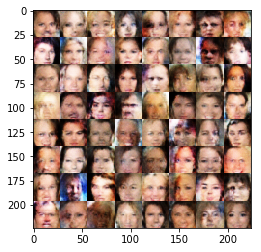

Epoch 5750/1... Discriminator Loss: 1.5158... Generator Loss: 0.5331


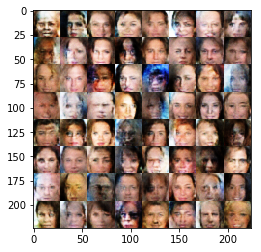

Epoch 5800/1... Discriminator Loss: 1.4467... Generator Loss: 0.4654


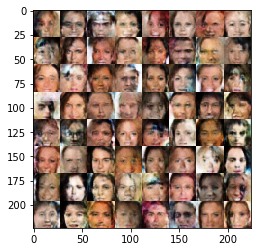

Epoch 5850/1... Discriminator Loss: 1.2323... Generator Loss: 0.7329


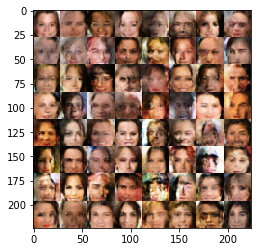

Epoch 5900/1... Discriminator Loss: 1.4936... Generator Loss: 0.4151


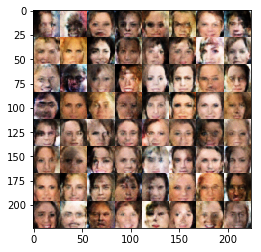

Epoch 5950/1... Discriminator Loss: 1.3420... Generator Loss: 0.6428


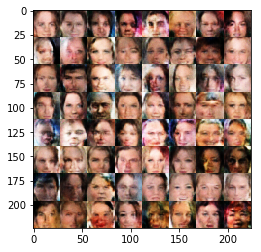

Epoch 6000/1... Discriminator Loss: 1.6719... Generator Loss: 0.3967


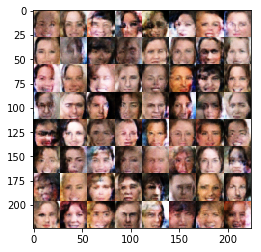

Epoch 6050/1... Discriminator Loss: 1.5087... Generator Loss: 0.4966


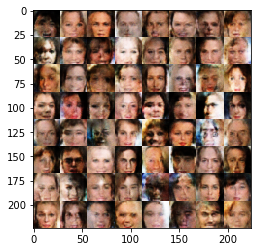

Epoch 6100/1... Discriminator Loss: 1.5244... Generator Loss: 0.4891


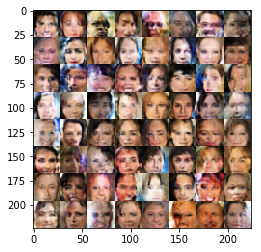

Epoch 6150/1... Discriminator Loss: 1.7160... Generator Loss: 0.6861


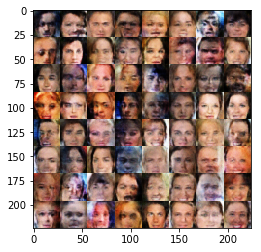

Epoch 6200/1... Discriminator Loss: 1.1945... Generator Loss: 0.8130


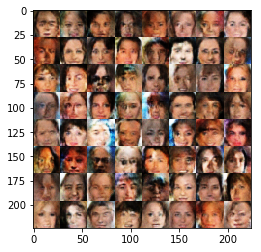

Epoch 6250/1... Discriminator Loss: 1.5519... Generator Loss: 0.6331


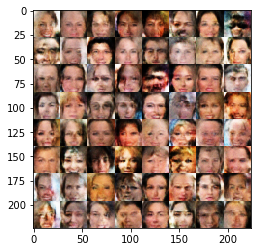

Epoch 6300/1... Discriminator Loss: 1.6880... Generator Loss: 0.3749


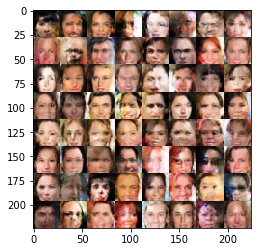

In [32]:
batch_size = 32
z_dim = 200
learning_rate = 0.0002
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.